# 机器学习纳米学位毕业项目 -- 猫狗大战
---

苗沛

2018.09.15

## 项目说明
---

使用深度学习方法识别一张图片是猫还是狗，这是一个二分类问题。1表示分类结果是狗，0表示分类结果是猫。

- 输入：一张彩色图片
- 输出：是猫还是狗

## 实验环境
---

项目使用Anaconda搭建环境。可是使用environment目录下的yml进行环境安装。

```shell
$ conda env create -f environment.yml
```

## 数据探索及预处理
---

从 [Dogs vs. Cats Redux: Kernels Edition](https://www.kaggle.com/c/dogs-vs-cats-redux-kernels-edition/data) 下载训练数据到`image目录` 并解压到当前目录。

数据集由训练数据和测试数据组成，训练数据包含猫和狗各12500张图片，测试数据包含12500张猫和狗的图片。

通过对图片中的色彩-像素比进行 IQR 分析，可以发现很多分辨率低、无关的图片，我们需要把不合格的图片删除

In [1]:
# 更改目录
import os

os.chdir("{}/image".format(os.getcwd()))

In [2]:
from PIL import Image
import os
import numpy as np
import shutil
from collections import Counter
import matplotlib.pyplot as plt

%matplotlib inline 

plt.style.use('seaborn-white')

targetnames = os.listdir('train/')
ratio_list = []

for name in targetnames[1:]:
    im = Image.open('train/' + name)
    x = im.histogram(mask=None)
    count = Counter(x)    
    ratio_list.append(float(len(count))/len(x))

In [3]:
import numpy as np

q99, q01 = np.percentile(ratio_list, [99, 1])

print(q99, q01)

0.802083333333 0.200520833333


Using TensorFlow backend.


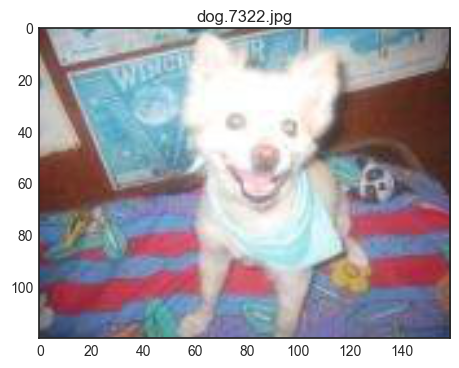

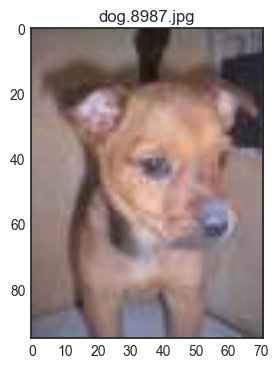

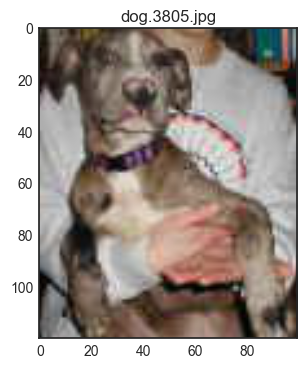

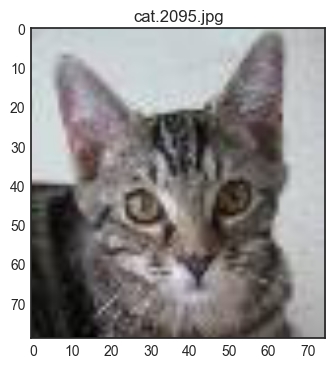

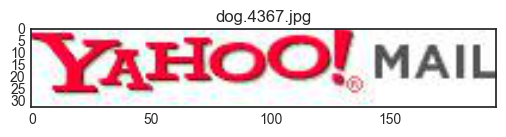

...

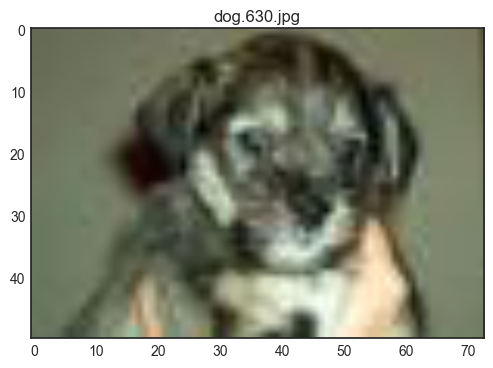

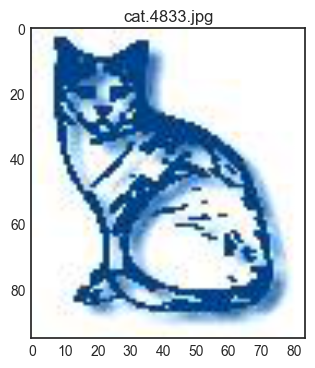

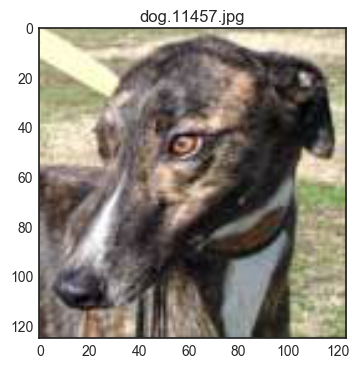

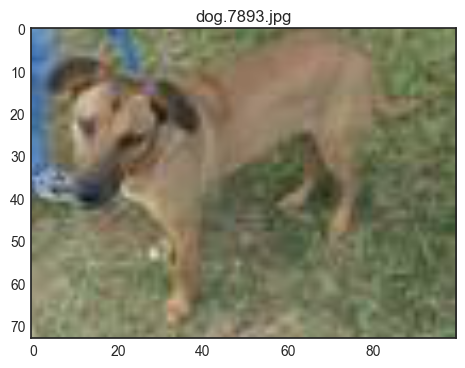

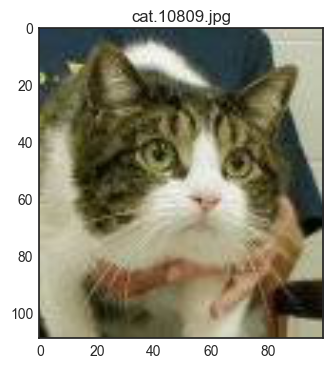

['dog.7322.jpg', 'dog.8987.jpg', 'dog.3805.jpg', 'cat.2095.jpg', 'dog.4367.jpg', 'dog.2892.jpg', 'dog.11248.jpg', 'cat.3980.jpg', 'cat.5671.jpg', 'dog.4777.jpg', 'cat.6386.jpg', 'dog.1197.jpg', 'dog.9246.jpg', 'cat.3567.jpg', 'cat.11879.jpg', 'dog.1381.jpg', 'cat.4963.jpg', 'dog.8428.jpg', 'dog.2139.jpg', 'dog.12185.jpg', 'dog.10989.jpg', 'dog.9130.jpg', 'cat.8744.jpg', 'cat.8585.jpg', 'dog.990.jpg', 'dog.3147.jpg', 'dog.9456.jpg', 'cat.10807.jpg', 'dog.12178.jpg', 'dog.1546.jpg', 'dog.11465.jpg', 'dog.10747.jpg', 'dog.10155.jpg', 'cat.7703.jpg', 'dog.9536.jpg', 'cat.2691.jpg', 'dog.2476.jpg', 'cat.3216.jpg', 'cat.575.jpg', 'cat.10392.jpg', 'dog.561.jpg', 'cat.3410.jpg', 'cat.2939.jpg', 'cat.5529.jpg', 'dog.5645.jpg', 'dog.12223.jpg', 'dog.10385.jpg', 'dog.4980.jpg', 'dog.10637.jpg', 'dog.7127.jpg', 'cat.7317.jpg', 'dog.10225.jpg', 'cat.11504.jpg', 'dog.943.jpg', 'dog.8570.jpg', 'dog.10190.jpg', 'dog.1353.jpg', 'dog.407.jpg', 'cat.7314.jpg', 'cat.8594.jpg', 'cat.11263.jpg', 'dog.7369.j

In [4]:
from keras.preprocessing.image import img_to_array, load_img
import shutil
import os
import matplotlib.pyplot as plt
from math import ceil
%matplotlib inline

plt.style.use('seaborn-white')

outlier_picture = []
targetnames = os.listdir('train/')
for name in targetnames[:]:
    im = Image.open('train/' + name)
    x = im.histogram(mask=None)
    count = Counter(x)
    if float(len(count))/len(x) < q01:
        outlier_picture.append(name)
        img = load_img('train/'+name)     
        x = img_to_array(img)
        plt.title(name)
        plt.imshow(img)
        plt.show()
        
print(outlier_picture)

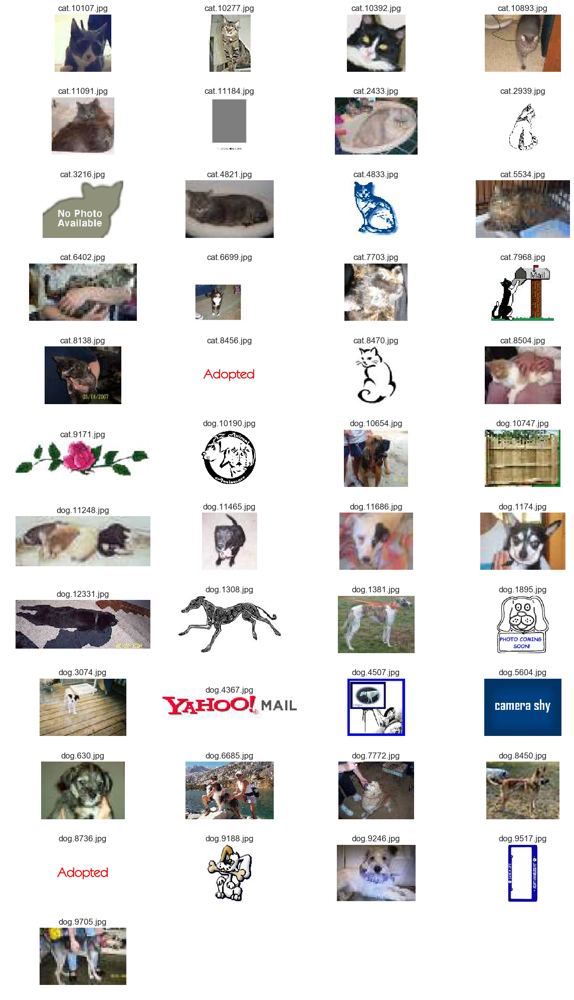

In [5]:
from keras.preprocessing.image import img_to_array, load_img
import shutil
import matplotlib.pyplot as plt
import os

def rmrf_mkdir(dirname):
    if os.path.exists(dirname):
        shutil.rmtree(dirname)
    os.mkdir(dirname)

rmrf_mkdir('outlier')

# pick out the outliers & low resolution pictures
outlier_list = ['cat.10107.jpg', 'cat.10277.jpg', 'cat.10392.jpg', 'cat.10893.jpg', 'cat.11091.jpg', 'cat.11184.jpg', 
                'cat.2433.jpg', 'cat.2939.jpg', 'cat.3216.jpg', 'cat.4821.jpg', 'cat.4833.jpg', 'cat.5534.jpg', 
                'cat.6402.jpg', 'cat.6699.jpg', 'cat.7703.jpg', 'cat.7968.jpg', 'cat.8138.jpg', 'cat.8456.jpg', 
               'cat.8470.jpg', 'cat.8504.jpg', 'cat.9171.jpg', 'dog.10190.jpg', 'dog.10654.jpg', 'dog.10747.jpg',
               'dog.11248.jpg', 'dog.11465.jpg', 'dog.11686.jpg', 'dog.1174.jpg', 'dog.12331.jpg', 'dog.1308.jpg',
               'dog.1381.jpg', 'dog.1895.jpg', 'dog.3074.jpg', 'dog.4367.jpg', 'dog.4507.jpg', 'dog.5604.jpg',
               'dog.630.jpg', 'dog.6685.jpg', 'dog.7772.jpg', 'dog.8450.jpg', 'dog.8736.jpg', 'dog.9188.jpg', 
               'dog.9246.jpg', 'dog.9517.jpg', 'dog.9705.jpg']

# remove these pictures out of the train/ directory
plt.figure(figsize=(12, 20))
for i in range(0, len(outlier_list)):
    plt.subplot(ceil(len(outlier_list) / 4), 4, i+1)
    img = load_img('train/'+ outlier_list[i])
    x = img_to_array(img)
    plt.title(outlier_list[i])
    plt.axis('off')
    plt.tight_layout()
    plt.imshow(img, interpolation="nearest")
    shutil.move('train/' + outlier_list[i], 'outlier/' + outlier_list[i])

数据集中的文件名是以type.num.jpg方式命名的，比如cat.0.jpg。使用 Keras 的 ImageDataGenerator 需要将不同种类的图片分在不同的文件夹中。对数据集进行预处理参考的是[杨培文的Blog](http://www.zhiding.cn/techwalker/documents/J9UpWRDfVYHE5WsOEHbyx4eM8fBcpHYEW_b72QCUihQ)创建符号链接(symbol link)的方法，这样的好处是不用复制一遍图片，占用不必要的空间。

In [6]:
import os
import shutil

train_filenames = os.listdir('train')
train_cat = filter(lambda x:x[:3] == 'cat', train_filenames)
train_dog = filter(lambda x:x[:3] == 'dog', train_filenames)

def rmrf_mkdir(dirname):
    if os.path.exists(dirname):
        shutil.rmtree(dirname)
    os.mkdir(dirname)

rmrf_mkdir('img_train')
os.mkdir('img_train/cat')
os.mkdir('img_train/dog')

rmrf_mkdir('img_test')
os.symlink('../test/', 'img_test/test')

for filename in train_cat:
    os.symlink('../../train/'+filename, 'img_train/cat/'+filename)

for filename in train_dog:
    os.symlink('../../train/'+filename, 'img_train/dog/'+filename)

## 生成迁移学习特征向量
---

In [7]:
from keras.models import *
from keras.layers import *
from keras.applications import *
from keras.preprocessing.image import *

import h5py

def write_gap(MODEL, image_size, lambda_func=None):
    width = image_size[0]
    height = image_size[1]
    input_tensor = Input((height, width, 3))
    x = input_tensor
    if lambda_func:
        x = Lambda(lambda_func)(x)
    
    base_model = MODEL(input_tensor=x, weights='imagenet', include_top=False, pooling='avg')
    model = Model(base_model.input, GlobalAveragePooling2D()(base_model.output))
    
    gen = ImageDataGenerator()
    train_generator = gen.flow_from_directory("img_train", image_size, shuffle=False, 
                                              batch_size=16)
    test_generator = gen.flow_from_directory("img_test", image_size, shuffle=False, 
                                             batch_size=16, class_mode=None)

    train = model.predict_generator(train_generator, train_generator.nb_sample)
    test = model.predict_generator(test_generator, test_generator.nb_sample)

    with h5py.File("gap_%s.h5"%MODEL.__name__) as h:
        h.create_dataset("train", data=train)
        h.create_dataset("test", data=test)
        h.create_dataset("label", data=train_generator.classes)

In [8]:
#write_gap(ResNet50, (224, 224))

In [9]:
#write_gap(InceptionV3, (299, 299), inception_v3.preprocess_input)

In [10]:
#write_gap(Xception, (299, 299), xception.preprocess_input)

## 载入特征向量
---

In [11]:
import h5py
import numpy as np
from sklearn.utils import shuffle
np.random.seed(2018)

X_train = []
X_test = []

for filename in ["gap_ResNet50.h5", "gap_Xception.h5", "gap_InceptionV3.h5"]:
    with h5py.File(filename, 'r') as h:
        X_train.append(np.array(h['train']))
        X_test.append(np.array(h['test']))
        y_train = np.array(h['label'])

X_train = np.concatenate(X_train, axis=1)
X_test = np.concatenate(X_test, axis=1)

X_train, y_train = shuffle(X_train, y_train)

## 构建模型
---

In [12]:
from keras.models import *
from keras.layers import *

input_tensor = Input(X_train.shape[1:])
x = input_tensor
x = Dropout(0.5)(x)
x = Dense(1, activation='sigmoid')(x)
model = Model(input_tensor, x)

model.compile(optimizer='adadelta',
              loss='binary_crossentropy',
              metrics=['accuracy'])

## 训练模型
---

In [13]:
# 模型概括
model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_1 (InputLayer)             (None, 6144)          0                                            
____________________________________________________________________________________________________
dropout_1 (Dropout)              (None, 6144)          0           input_1[0][0]                    
____________________________________________________________________________________________________
dense_1 (Dense)                  (None, 1)             6145        dropout_1[0][0]                  
Total params: 6,145
Trainable params: 6,145
Non-trainable params: 0
____________________________________________________________________________________________________


In [14]:
from keras.callbacks import *

model_history = model.fit(X_train, 
                    y_train,
                    batch_size=128,
                    nb_epoch=8,
                    verbose=1,
                    validation_split=0.2,
                    callbacks = [TensorBoard(log_dir='./Graph')])

model.save('model.h5')

Train on 20000 samples, validate on 5000 samples
Epoch 1/8
20000/20000 [==============================] - 2s - loss: 0.1099 - acc: 0.9651 - val_loss: 0.0309 - val_acc: 0.9912
Epoch 2/8
20000/20000 [==============================] - 2s - loss: 0.0286 - acc: 0.9919 - val_loss: 0.0224 - val_acc: 0.9922
Epoch 3/8
20000/20000 [==============================] - 2s - loss: 0.0237 - acc: 0.9922 - val_loss: 0.0197 - val_acc: 0.9934
Epoch 4/8
20000/20000 [==============================] - 2s - loss: 0.0202 - acc: 0.9938 - val_loss: 0.0183 - val_acc: 0.9940
Epoch 5/8
20000/20000 [==============================] - 2s - loss: 0.0190 - acc: 0.9934 - val_loss: 0.0175 - val_acc: 0.9938
Epoch 6/8
20000/20000 [==============================] - 2s - loss: 0.0168 - acc: 0.9942 - val_loss: 0.0173 - val_acc: 0.9948
Epoch 7/8
20000/20000 [==============================] - 2s - loss: 0.0155 - acc: 0.9950 - val_loss: 0.0173 - val_acc: 0.9942
Epoch 8/8
20000/20000 [==============================] - 2s - loss: 0

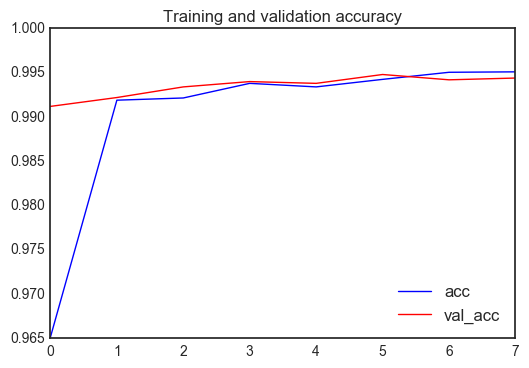

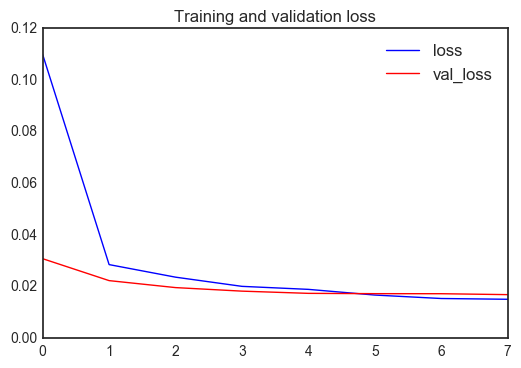

In [15]:
import matplotlib.pyplot as plt
%matplotlib inline
# 画图
def plot_training(history):
    acc = history.history['acc']
    val_acc = history.history['val_acc']
    epochs = range(len(acc))
    plt.plot(epochs, acc, 'b')
    plt.plot(epochs, val_acc, 'r')
    plt.legend(["acc", "val_acc"], loc='best')
    plt.title('Training and validation accuracy')
    plt.figure()

    loss = history.history['loss']
    val_loss = history.history['val_loss']   
    plt.plot(epochs, loss, 'b')
    plt.plot(epochs, val_loss, 'r')
    plt.legend(["loss", "val_loss"], loc='best')
    plt.title('Training and validation loss')
    plt.show()

# 训练的acc_loss图
plot_training(model_history)

## 预测测试集
---

In [16]:
import pandas as pd
from keras.preprocessing.image import *

df = pd.read_csv("sample_submission.csv")

image_size = (224, 224)
gen = ImageDataGenerator()
test_generator = gen.flow_from_directory("img_test", image_size, shuffle=False, 
                                         batch_size=16, class_mode=None)

y_pred = model.predict(X_test, verbose=1)
y_pred = y_pred.clip(min=0.005, max=0.995)

for i, fname in enumerate(test_generator.filenames):
    index = int(fname[fname.rfind('/')+1:fname.rfind('.')])
    df.set_value(index-1, 'label', y_pred[i])

df.to_csv('pred.csv', index=None)
df.head(10)

Found 12500 images belonging to 1 classes.
11680/12500 [===========================>..] - ETA: 0s

/Users/miclaelmiao/anaconda2/envs/cat_vs_dog/lib/python3.5/site-packages/ipykernel/__main__.py:16: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessors instead


,id,label
0,1,0.995
1,2,0.995
2,3,0.995
3,4,0.995
4,5,0.005
5,6,0.005
6,7,0.005
7,8,0.005
8,9,0.005
9,10,0.005
